# Breast Cancer Classification and Prediction Using Machine Learning

## Resumen

El cáncer de mama es una de las principales causas de mortalidad en mujeres a nivel mundial, por lo que el diagnostico temprano resulta escencial para mejorar el pronóstico y la tasa de supervivencia. En este proyecto se desarrolló un sistema de clasificación basado en machine learning utilizando el conjunto de datos de Wisconsin Breast Cancer. Se realizó un análisis exploratorio de datos (EDA) con visualización de distribuciones, correlaciones y reducción de dimensionalidad mediante PCA, MDS y t-SNE. Posteriomente, se implementaron modelos supervisados como Multilayer Perceptron (MLP), Support Vector Machine (SVM) y Random Forest, optimizados a través de validacion cruzada y Grid Search. Los modelos alcazaron altos niveles de desempeño, con valores promedio de AUC susperiores a 0.95 y recall elevados, lo que es crucial para minimizar falsos negativos. El trabajo aporta una comparacion sistemática entre distintos enfoques y propone ajustes de umbral de decisión orientados a maximizar la sensibilidad diagnóstica. Estos resultados evidencian el potencial de las técnicas de machine learning como herramientas complementarias para apoyar la toma de decisiones clínicas en el diagnóstico tempreno del cáncer de mama.

## Abstract

Breast cancer is one of the leading causes of mortality among women worldwide, making early diagnosis critical to improving prognosis and survival rates. This project presents a machine learning-based classification system using the Wisconsin Breast Cancer dataset. An exploratory data analysis (EDA) was conducted, including distribution visualization, correlation mapping, and dimensionality rediction with PCA, MDS, and t-SNE. Supervised learning models such as Multilayer Perceptron (MLP), Support Vector Machine (SVM), and Random Forest were implemented and optimized through cross-validation and Grid Search. The models archieved high predictive perfomance, with average AUC scores above 0.95 and strong recall values, which are essential to minimizing false negatives. Futhermore, decision threshold adjusments were explored to prioritize diagnostic sensitivity. This work provides a systematic comparison of different approarches and highlights the potential of machine learning techniques as complementary tools to support clinical decision-making in the early detection of breast cancer.

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

url = "https://raw.githubusercontent.com/Rafagars/Breast-Cancer-Classification-and-Predictor/refs/heads/main/data/Breast_cancer_dataset.csv"

data = pd.read_csv(url)

In [3]:
data = data.drop(columns=['id', 'Unnamed: 32'], axis=1)
data

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


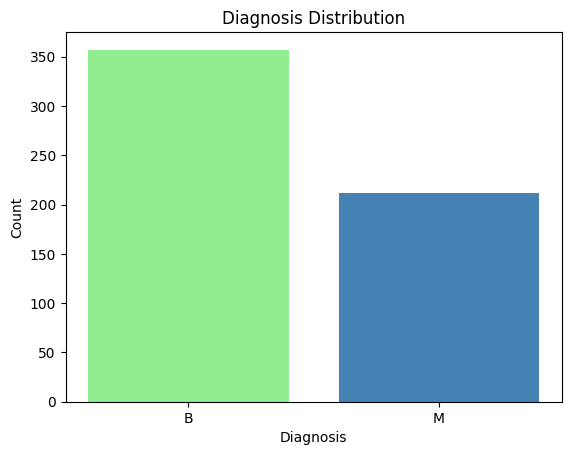

In [ ]:
#@title Bar Graph of the Diagnosis Distribution
plt.bar(data['diagnosis'].value_counts().index, data['diagnosis'].value_counts(), color=['lightgreen', 'steelblue'])
plt.xlabel('Diagnosis')
plt.ylabel('Count')
plt.title('Diagnosis Distribution')
plt.show()

We can see that we have around 350 benign cases and 200 malignant cases in our data

In [ ]:
#@title Summary of our data
data.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [ ]:
#@title Pair Plots
sns.pairplot(data, hue='diagnosis')
plt.show()

The data pairs give us the relevant information that for most of the cases there is a clear distintion between a benign tumor and a malignant one

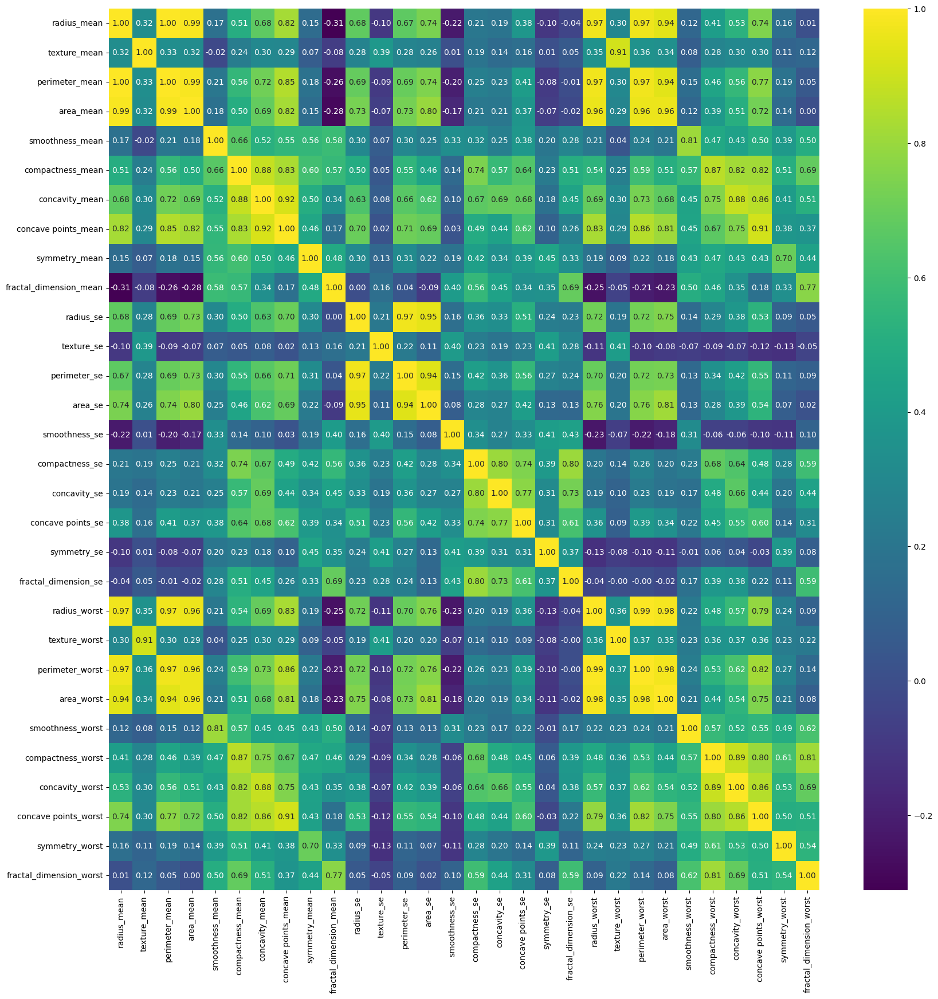

In [ ]:
#@title Correlation Matrix
plt.figure(figsize=(20, 20))
sns.heatmap(data.loc[:, data.columns != 'diagnosis'].corr(), annot=True, cmap='viridis', fmt = '.2f')
plt.show()

A lot of the variables/dimensions are deeply correlated.

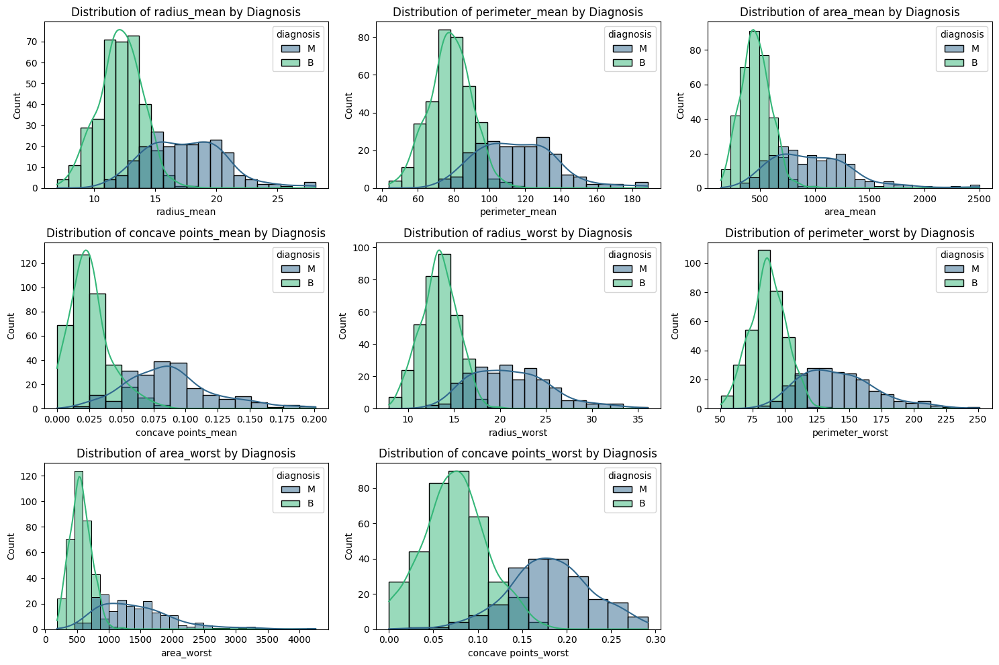

In [ ]:
# Select a few features that appear to have high correlation with the diagnosis
features_to_plot = ['radius_mean', 'perimeter_mean', 'area_mean', 'concave points_mean', 'radius_worst', 'perimeter_worst', 'area_worst', 'concave points_worst']

plt.figure(figsize=(15, 10))
for i, feature in enumerate(features_to_plot):
    plt.subplot(3, 3, i + 1)
    sns.histplot(data=data, x=feature, hue='diagnosis', kde=True, palette='viridis')
    plt.title(f'Distribution of {feature} by Diagnosis')
plt.tight_layout()
plt.show()

## Load the libraries for the Dimensionality Reduction. We are going to use MDS, PCA and t-SNE

In [4]:
from sklearn.datasets import make_blobs
from sklearn.manifold import TSNE, MDS

Original Dimension of X :  (569, 31)
Dimension of X after MDS :  (569, 2)


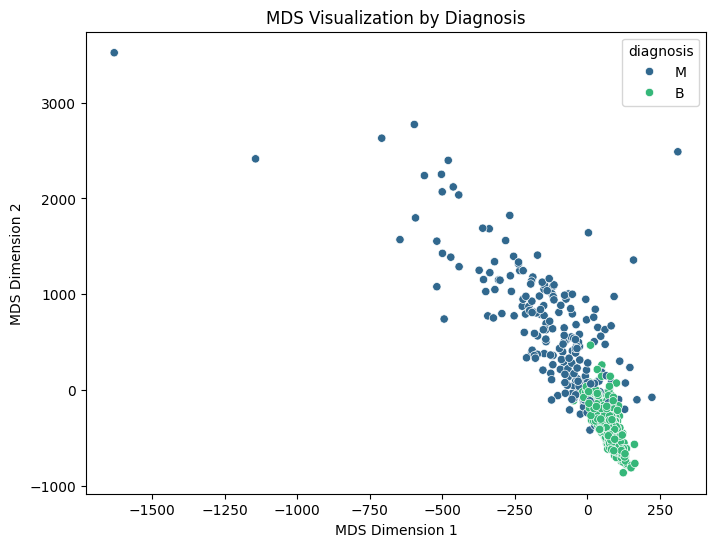

In [5]:
#@title MDS
breast_mds = MDS(n_components=2, random_state=42).fit_transform(data.drop('diagnosis', axis=1))

print('Original Dimension of X : ', data.shape)
print('Dimension of X after MDS : ', breast_mds.shape)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=breast_mds[:, 0], y=breast_mds[:, 1], hue=data['diagnosis'], palette='viridis')
plt.title('MDS Visualization by Diagnosis')
plt.xlabel('MDS Dimension 1')
plt.ylabel('MDS Dimension 2')

plt.show()

Original Dimension of X :  (569, 31)
Dimension of X after t-SNE :  (569, 2)


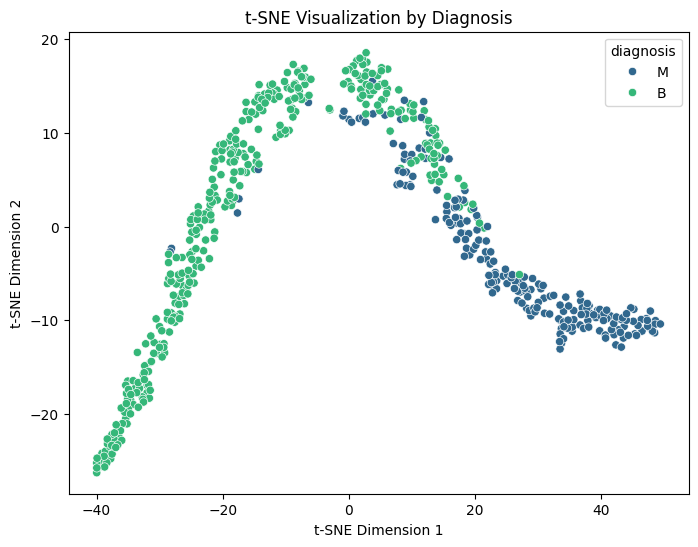

In [6]:
#@title t-SNE
breast_tsne = TSNE(n_components=2, random_state=42).fit_transform(data.drop('diagnosis', axis=1))

print('Original Dimension of X : ', data.shape)
print('Dimension of X after t-SNE : ', breast_tsne.shape)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=breast_tsne[:, 0], y=breast_tsne[:, 1], hue=data['diagnosis'], palette='viridis')
plt.title('t-SNE Visualization by Diagnosis')
plt.xlabel('t-SNE Dimension 1')
plt.ylabel('t-SNE Dimension 2')

plt.show()

Original Dimension of X :  (569, 31)
Dimension of X after PCA :  (569, 2)


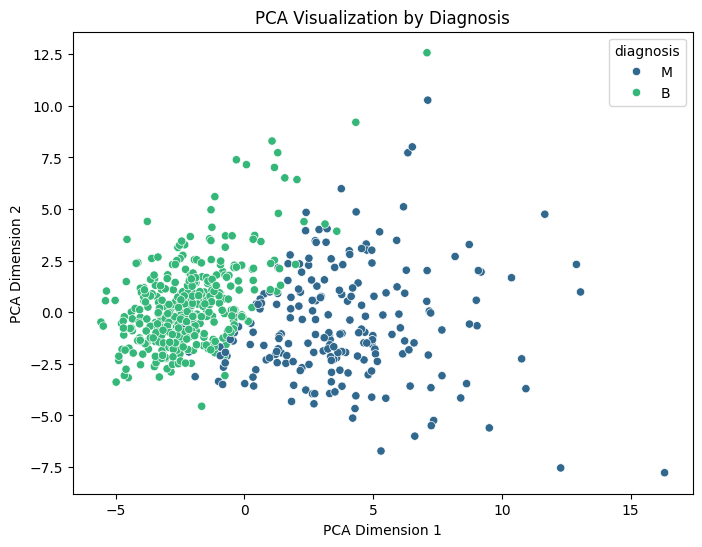

In [7]:
#@title PCA
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

scaled_data = StandardScaler().fit_transform(data.drop('diagnosis', axis=1))
pca = PCA(n_components=2)
breast_pca = pca.fit_transform(scaled_data)

print('Original Dimension of X : ', data.shape)
print('Dimension of X after PCA : ', breast_pca.shape)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=breast_pca[:, 0], y=breast_pca[:, 1], hue=data['diagnosis'], palette='viridis')
plt.title('PCA Visualization by Diagnosis')
plt.xlabel('PCA Dimension 1')
plt.ylabel('PCA Dimension 2')

plt.show()

In [8]:
# The explained_variance_ratio_ tells us the percentage of variance explained by each component
exp_var_ratio = pca.explained_variance_ratio_

# To get the total variance retained by the selected components (in this case, 2), sum the ratios
total_var_ret = sum(exp_var_ratio)

print(f'Percentage of variance retained by the 2 PCA components: {total_var_ret:.4f}')

Percentage of variance retained by the 2 PCA components: 0.6324


PCA gives us a good classification of Benign and Malignant Tumors but it only explains around 63% of the variance, which means that we need more dimensions, specially if we want to use these new dimensiones for a machine learning model.

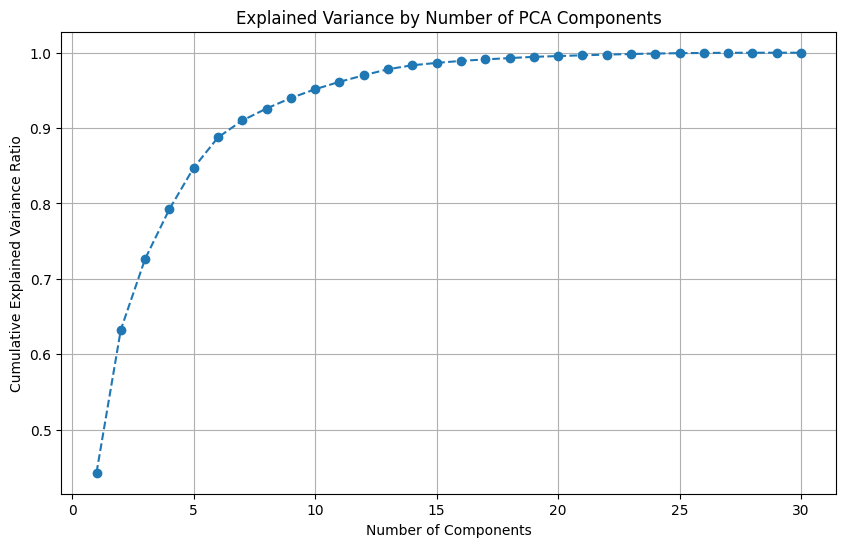

In [9]:
# Fit PCA with all components to see explained variance for each
pca_full = PCA()
pca_full.fit(scaled_data)

# Calculate the cumulative explained variance
cumulative_explained_variance = np.cumsum(pca_full.explained_variance_ratio_)

# Plot the cumulative explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, marker='o', linestyle='--')
plt.title('Explained Variance by Number of PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.grid(True)
plt.show()

It seems like we would need around 6 components to get close to 0.9 of the variance.

In [10]:
from sklearn.metrics import silhouette_score

# Calculate silhouette score for MDS
mds_silhouette = silhouette_score(breast_mds, data['diagnosis'].astype('category').cat.codes)
print(f'Silhouette Score for MDS: {mds_silhouette:.4f}')

# Calculate silhouette score for t-SNE
tsne_silhouette = silhouette_score(breast_tsne, data['diagnosis'].astype('category').cat.codes)
print(f'Silhouette Score for t-SNE: {tsne_silhouette:.4f}')

# Calculate silhouette score for PCA
pca_silhouette = silhouette_score(breast_pca, data['diagnosis'].astype('category').cat.codes)
print(f'Silhouette Score for PCA: {pca_silhouette:.4f}')

Silhouette Score for MDS: 0.5149
Silhouette Score for t-SNE: 0.4342
Silhouette Score for PCA: 0.4377


Using Silhouette Score we can see that only MDS gives us a moderate score

## Machine Learning Model

### Multilayer Perceptron

In [11]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(data.drop('diagnosis', axis=1), data['diagnosis'], test_size=0.2, random_state=42)

clf = MLPClassifier(hidden_layer_sizes=(100, 50), max_iter=1000, random_state=42)
clf.fit(X_train, y_train)

print(f'Training Accuracy: {clf.score(X_train, y_train):.4f}')
print(f'Testing Accuracy: {clf.score(X_test, y_test):.4f}')

Training Accuracy: 0.9385
Testing Accuracy: 0.9386


In [12]:
y_pred = clf.predict(X_test)
y_pred

array(['M', 'M', 'M', 'B', 'B', 'M', 'M', 'M', 'B', 'B', 'B', 'M', 'B',
       'M', 'B', 'M', 'B', 'B', 'B', 'M', 'M', 'B', 'M', 'B', 'B', 'B',
       'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'B', 'M',
       'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'M',
       'B', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'M', 'B', 'B',
       'B', 'M', 'M', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B',
       'B', 'B', 'M', 'B', 'B', 'M', 'M', 'B', 'M', 'M', 'B', 'B', 'B',
       'B', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'M', 'M', 'B', 'M', 'M',
       'B', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'M'], dtype='<U1')

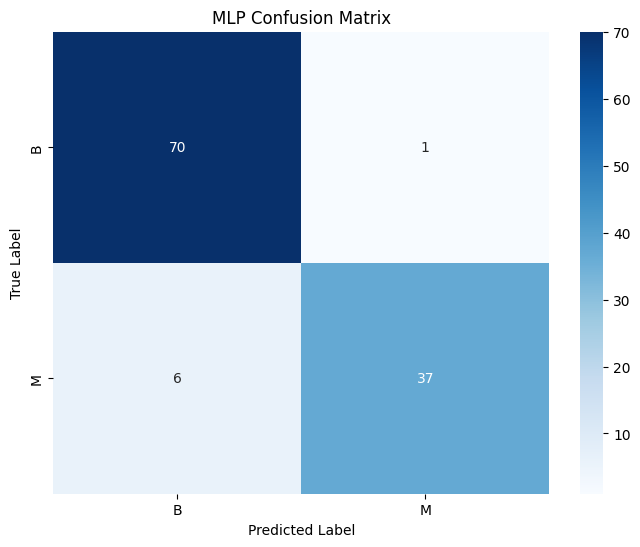

In [13]:
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test, y_pred)

# Visualizar la matriz de confusión
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['B', 'M'], yticklabels=['B', 'M'])
plt.title('MLP Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [14]:
from sklearn.metrics import classification_report, roc_auc_score

# Print classification report
print(classification_report(y_test, y_pred))

y_test_numeric = y_test.astype('category').cat.codes
y_pred_proba = clf.predict_proba(X_test)[:, 1] # Probability of the positive class (Malignant)

auc_score = roc_auc_score(y_test_numeric, y_pred_proba)
print(f'AUC Score: {auc_score:.4f}')

              precision    recall  f1-score   support

           B       0.92      0.99      0.95        71
           M       0.97      0.86      0.91        43

    accuracy                           0.94       114
   macro avg       0.95      0.92      0.93       114
weighted avg       0.94      0.94      0.94       114

AUC Score: 0.9918


### Now lets see if it changes using one of our dimensionality-reduced data

In [38]:
#@title Using PCA dimensionality reduced data
X_train, X_test, y_train, y_test = train_test_split(breast_pca, data['diagnosis'], test_size=0.2, random_state=42)

clf = MLPClassifier(hidden_layer_sizes=(100, 50), max_iter=1000, random_state=42)
clf.fit(X_train, y_train)

print(f'Training Accuracy: {clf.score(X_train, y_train):.4f}')
print(f'Testing Accuracy: {clf.score(X_test, y_test):.4f}')

Training Accuracy: 0.9495
Testing Accuracy: 0.9912


In [39]:
y_pred = clf.predict(X_test)
y_pred

array(['B', 'M', 'M', 'B', 'B', 'M', 'M', 'M', 'B', 'B', 'B', 'M', 'B',
       'M', 'B', 'M', 'B', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'B',
       'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'B', 'M',
       'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'M',
       'B', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'B', 'M', 'M', 'B', 'B',
       'B', 'M', 'M', 'B', 'B', 'M', 'M', 'B', 'M', 'B', 'B', 'B', 'M',
       'B', 'B', 'M', 'B', 'M', 'M', 'M', 'M', 'M', 'M', 'B', 'B', 'B',
       'B', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'M', 'M', 'B', 'M', 'M',
       'B', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'M'], dtype='<U1')

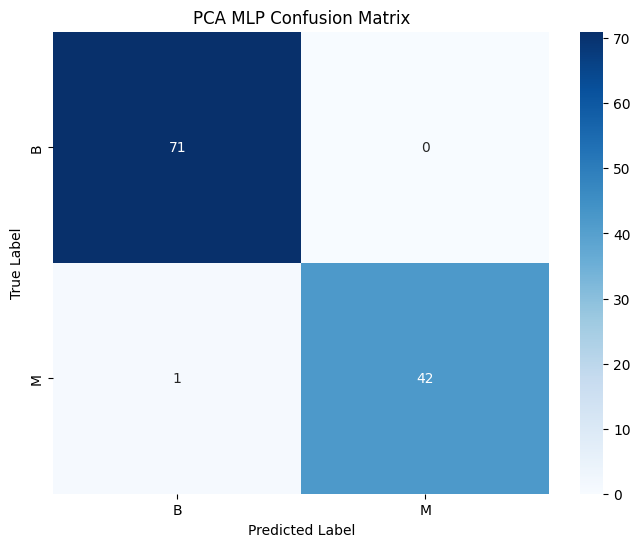

In [40]:
#@title PCA Confusion Matrix

cm = confusion_matrix(y_test, y_pred)

# Visualizar la matriz de confusión
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['B', 'M'], yticklabels=['B', 'M'])
plt.title('PCA MLP Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [17]:
# Print classification report
print(classification_report(y_test, y_pred))

y_test_numeric = y_test.astype('category').cat.codes
y_pred_proba = clf.predict_proba(X_test)[:, 1] # Probability of the positive class (Malignant)

auc_score = roc_auc_score(y_test_numeric, y_pred_proba)
print(f'AUC Score: {auc_score:.4f}')

              precision    recall  f1-score   support

           B       0.92      0.99      0.95        71
           M       0.97      0.86      0.91        43

    accuracy                           0.94       114
   macro avg       0.95      0.92      0.93       114
weighted avg       0.94      0.94      0.94       114

AUC Score: 0.9984


The PCA reduced data give us a much better result with only one false positive for a malignant tumor. It seems like the PCA two dimensional data does a great data explaining what is neccesary for the tumor classification

In [33]:
#@title Hyperparameter Tuning
from sklearn.model_selection import GridSearchCV

param_grid_mlp = {
    'hidden_layer_sizes': [(50,), (100,), (50, 50), (100, 50)],
    'activation': ['tanh', 'relu'],
    'alpha': [0.0001, 0.001, 0.01]
}

mlp = MLPClassifier(max_iter=1000, random_state=42)

grid_search_mlp = GridSearchCV(mlp, param_grid_mlp, cv=5, scoring='accuracy')

grid_search_mlp.fit(X_train, y_train)

print("Best parameters for MLP:", grid_search_mlp.best_params_)
print("Best cross-validation score for MLP:", grid_search_mlp.best_score_)

Best parameters for MLP: {'activation': 'relu', 'alpha': 0.01, 'hidden_layer_sizes': (100,)}
Best cross-validation score for MLP: 0.945054945054945


The Grid Search recommends a relu function for the activation with only one hidden layer of 100 neurons

### SVM

In [41]:
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline

X_train, X_test, y_train, y_test = train_test_split(data.drop('diagnosis', axis=1), data['diagnosis'], test_size=0.2, random_state=42)

clf = make_pipeline(StandardScaler(), SVC(kernel='rbf'))
clf.fit(X_train, y_train)

print(f'Training Accuracy: {clf.score(X_train, y_train):.4f}')
print(f'Testing Accuracy: {clf.score(X_test, y_test):.4f}')

Training Accuracy: 0.9890
Testing Accuracy: 0.9825


In [42]:
y_pred = clf.predict(X_test)
y_pred

array(['B', 'M', 'M', 'B', 'B', 'M', 'M', 'M', 'B', 'B', 'B', 'M', 'B',
       'M', 'B', 'M', 'B', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'B',
       'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'B', 'M',
       'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'M',
       'B', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'B', 'M', 'M', 'B', 'B',
       'B', 'M', 'M', 'B', 'B', 'M', 'M', 'B', 'M', 'B', 'B', 'B', 'B',
       'B', 'B', 'M', 'B', 'M', 'M', 'M', 'M', 'M', 'M', 'B', 'B', 'B',
       'B', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'M', 'M', 'B', 'M', 'M',
       'B', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'M'], dtype=object)

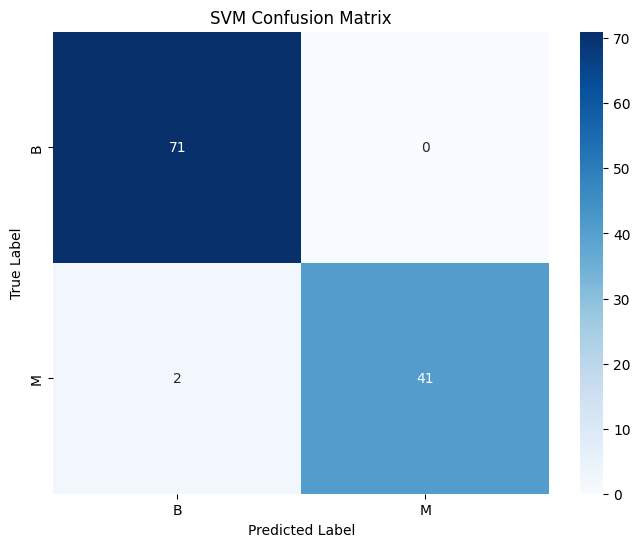

In [43]:
cm = confusion_matrix(y_test, y_pred)

# Visualizar la matriz de confusión
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['B', 'M'], yticklabels=['B', 'M'])
plt.title('SVM Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

Almost as good as our MLP model with PCA data

In [48]:
# Predict on the test data
y_pred = clf.predict(X_test)

# Print classification report
print(classification_report(y_test, y_pred))

# Convert y_test to numeric for AUC calculation
y_test_numeric = y_test.astype('category').cat.codes

# Get probability estimates for the positive class (Malignant)
y_pred_proba = clf.decision_function(X_test)

# Calculate and print AUC score
auc_score = roc_auc_score(y_test_numeric, y_pred_proba)
print(f'AUC Score: {auc_score:.4f}')

              precision    recall  f1-score   support

           B       0.97      1.00      0.99        71
           M       1.00      0.95      0.98        43

    accuracy                           0.98       114
   macro avg       0.99      0.98      0.98       114
weighted avg       0.98      0.98      0.98       114

AUC Score: 0.9974


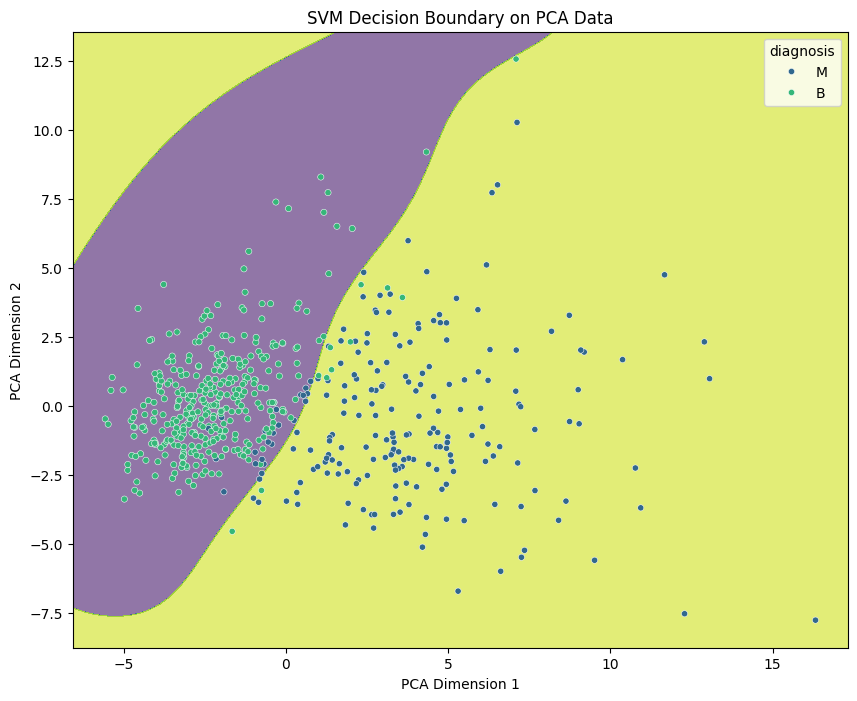

In [21]:
#@title Plot Decision Boundary using SVM for the PCA data
# Separate features and target
X = data.drop('diagnosis', axis=1)
y = data['diagnosis']

# Scale the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Train an SVM model on the scaled data
svm_clf = SVC(kernel='rbf') # Using the same kernel as before
svm_clf.fit(X_scaled, y)

# Use the previously calculated PCA components
X_pca = breast_pca

# Split the PCA data into training and testing sets
X_train_pca, X_test_pca, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

# Train an SVM model on the 2D PCA data
svm_pca = SVC(kernel='rbf')
svm_pca.fit(X_train_pca, y_train)

# Create a meshgrid to plot the decision boundary on the PCA space
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01),
                     np.arange(y_min, y_max, 0.01))

# Predict the class for each point in the meshgrid
Z = svm_pca.predict(np.c_[xx.ravel(), yy.ravel()])

# Convert predictions to numerical values (0 for B, 1 for M)
Z = np.where(Z == 'M', 1, 0)

Z = Z.reshape(xx.shape)

# Plot the decision boundary and the data points
plt.figure(figsize=(10, 8))
plt.contourf(xx, yy, Z, alpha=0.6, cmap='viridis')
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=y, palette='viridis', s=20)
plt.title('SVM Decision Boundary on PCA Data')
plt.xlabel('PCA Dimension 1')
plt.ylabel('PCA Dimension 2')
plt.show()

In [22]:
#@title For curiosity we are going to test using a polynomial kernel
clf = make_pipeline(StandardScaler(), SVC(kernel='poly', degree=3))
clf.fit(X_train, y_train)

print(f'Training Accuracy: {clf.score(X_train, y_train):.4f}')
print(f'Testing Accuracy: {clf.score(X_test, y_test):.4f}')

Training Accuracy: 0.9143
Testing Accuracy: 0.8684


In [23]:
#@title Degree = 4
clf = make_pipeline(StandardScaler(), SVC(kernel='poly', degree=4))
clf.fit(X_train, y_train)

print(f'Training Accuracy: {clf.score(X_train, y_train):.4f}')
print(f'Testing Accuracy: {clf.score(X_test, y_test):.4f}')

Training Accuracy: 0.8440
Testing Accuracy: 0.7895


In [24]:
#@title Degree = 5
clf = make_pipeline(StandardScaler(), SVC(kernel='poly', degree=5))
clf.fit(X_train, y_train)

print(f'Training Accuracy: {clf.score(X_train, y_train):.4f}')
print(f'Testing Accuracy: {clf.score(X_test, y_test):.4f}')

Training Accuracy: 0.8659
Testing Accuracy: 0.8158


The best one was degree 3 but it wasn't as good as the rbf kernel. More degrees doesn't seem to help at all

In [25]:
#@title Linear Kernel
clf = make_pipeline(StandardScaler(), SVC(kernel='linear'))
clf.fit(X_train, y_train)

print(f'Training Accuracy: {clf.score(X_train, y_train):.4f}')
print(f'Testing Accuracy: {clf.score(X_test, y_test):.4f}')

Training Accuracy: 0.9868
Testing Accuracy: 0.9561


Not bad but still isn't as good as the Rbf kernel.

In [34]:
#@title Hyperparameter Tuning
param_grid_svm = {
    'svc__C': [0.1, 1, 10, 100],
    'svc__gamma': ['scale', 'auto', 0.01, 0.1, 1],
    'svc__kernel': ['rbf', 'linear']
}

svm_pipe = make_pipeline(StandardScaler(), SVC(random_state=42))

grid_search_svm = GridSearchCV(svm_pipe, param_grid_svm, cv=5, scoring='accuracy')

grid_search_svm.fit(X_train, y_train)

print("Best parameters for SVM:", grid_search_svm.best_params_)
print("Best cross-validation score for SVM:", grid_search_svm.best_score_)

Best parameters for SVM: {'svc__C': 0.1, 'svc__gamma': 'scale', 'svc__kernel': 'linear'}
Best cross-validation score for SVM: 0.9736263736263737


But it seems like Grid Search recommends a linear kernel instead


### Random Forest

In [26]:
from sklearn.ensemble import RandomForestClassifier

X_train, X_test, y_train, y_test = train_test_split(data.drop('diagnosis', axis=1), data['diagnosis'], test_size=0.2, random_state=42)

clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train, y_train)

print(f'Training Accuracy: {clf.score(X_train, y_train):.4f}')
print(f'Testing Accuracy: {clf.score(X_test, y_test):.4f}')

Training Accuracy: 1.0000
Testing Accuracy: 0.9649


In [31]:
# Predict on the test data
y_pred = clf.predict(X_test)

# Print classification report
print(classification_report(y_test, y_pred))

# Convert y_test to numeric for AUC calculation
y_test_numeric = y_test.astype('category').cat.codes

# Get probability estimates for the positive class (Malignant)
y_pred_proba = clf.predict_proba(X_test)[:, 1]

# Calculate and print AUC score
auc_score = roc_auc_score(y_test_numeric, y_pred_proba)
print(f'AUC Score: {auc_score:.4f}')

              precision    recall  f1-score   support

           B       0.96      0.99      0.97        71
           M       0.98      0.93      0.95        43

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114

AUC Score: 0.9953


/tmp/ipython-input-2857606.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=sorted_importance.values, y=sorted_importance.index, palette='viridis')


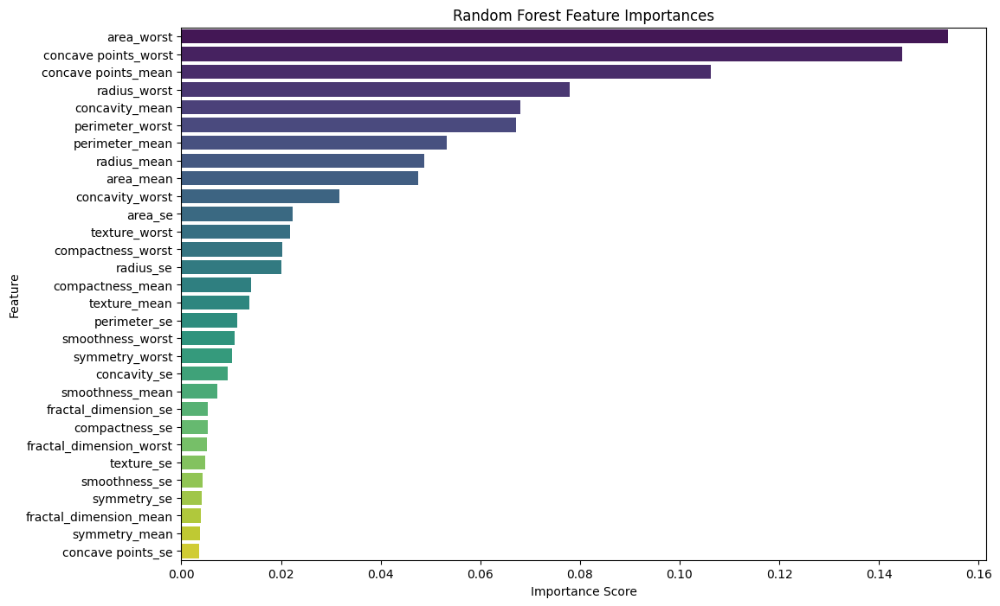

In [30]:
#@title Feature Importances
# Get feature importances from the trained Random Forest model
feature_importances = clf.feature_importances_

# Get the names of the features (columns excluding 'diagnosis')
feature_names = data.drop('diagnosis', axis=1).columns

# Create a pandas Series for easier handling and sorting
importance_series = pd.Series(feature_importances, index=feature_names)

# Sort feature importances in descending order
sorted_importance = importance_series.sort_values(ascending=False)

# Plot the feature importances
plt.figure(figsize=(12, 8))
sns.barplot(x=sorted_importance.values, y=sorted_importance.index, palette='viridis')
plt.title('Random Forest Feature Importances')
plt.xlabel('Importance Score')
plt.ylabel('Feature')
plt.show()

It seems like the area worst is the most important feature for the model, followed by concave points worse and mean. Which mean the worst value of the area of the tumor and its concave points are the most influential features for the classification of the tumor.

In [35]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

param_grid_rf = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10]
}

rf_clf = RandomForestClassifier(random_state=42)

grid_search_rf = GridSearchCV(rf_clf, param_grid_rf, cv=5, scoring='accuracy')

grid_search_rf.fit(X_train, y_train)

print("Best parameters for Random Forest:", grid_search_rf.best_params_)
print("Best cross-validation score for Random Forest:", grid_search_rf.best_score_)

Best parameters for Random Forest: {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 200}
Best cross-validation score for Random Forest: 0.9626373626373625


In [36]:
#@title Evaluate tuned models
from sklearn.metrics import classification_report, roc_auc_score

# Get the best estimators
best_mlp = grid_search_mlp.best_estimator_
best_svm = grid_search_svm.best_estimator_
best_rf = grid_search_rf.best_estimator_

# Make predictions and evaluate MLP
y_pred_mlp = best_mlp.predict(X_test)
print("MLP Performance:")
print(classification_report(y_test, y_pred_mlp))
y_test_numeric = y_test.astype('category').cat.codes
y_pred_proba_mlp = best_mlp.predict_proba(X_test)[:, 1]
auc_score_mlp = roc_auc_score(y_test_numeric, y_pred_proba_mlp)
print(f'AUC Score: {auc_score_mlp:.4f}')
print("-" * 30)

# Make predictions and evaluate SVM
y_pred_svm = best_svm.predict(X_test)
print("SVM Performance:")
print(classification_report(y_test, y_pred_svm))
# SVM with 'linear' kernel does not have predict_proba, need to set probability=True during initialization or use decision_function
# Based on the previous run, the best SVM kernel was 'linear'. Let's check if the best_svm has predict_proba
try:
    y_pred_proba_svm = best_svm.predict_proba(X_test)[:, 1]
except AttributeError:
    # If predict_proba is not available, use decision_function and convert to probabilities if needed
    # For AUC with decision_function, we can directly use decision_function scores if they represent confidence
    y_pred_proba_svm = best_svm.decision_function(X_test)
auc_score_svm = roc_auc_score(y_test_numeric, y_pred_proba_svm)
print(f'AUC Score: {auc_score_svm:.4f}')
print("-" * 30)

# Make predictions and evaluate Random Forest
y_pred_rf = best_rf.predict(X_test)
print("Random Forest Performance:")
print(classification_report(y_test, y_pred_rf))
y_pred_proba_rf = best_rf.predict_proba(X_test)[:, 1]
auc_score_rf = roc_auc_score(y_test_numeric, y_pred_proba_rf)
print(f'AUC Score: {auc_score_rf:.4f}')
print("-" * 30)

MLP Performance:
              precision    recall  f1-score   support

           B       0.91      1.00      0.95        71
           M       1.00      0.84      0.91        43

    accuracy                           0.94       114
   macro avg       0.96      0.92      0.93       114
weighted avg       0.94      0.94      0.94       114

AUC Score: 0.9905
------------------------------
SVM Performance:
              precision    recall  f1-score   support

           B       0.97      1.00      0.99        71
           M       1.00      0.95      0.98        43

    accuracy                           0.98       114
   macro avg       0.99      0.98      0.98       114
weighted avg       0.98      0.98      0.98       114

AUC Score: 0.9974
------------------------------
Random Forest Performance:
              precision    recall  f1-score   support

           B       0.96      0.99      0.97        71
           M       0.98      0.93      0.95        43

    accuracy           